In [1]:
import numpy as np
import matplotlib.pyplot as plt

import cv2
import os
import utils
import turn
import analysis
import PIL
import skimage
from tqdm.notebook import tqdm

In [ ]:
file_name = "./data/photos/img4.jpg"
original = utils.imread(file_name)
original

In [ ]:
plt.imshow(np.fft.fftshift(np.log(np.abs(np.fft.fft2(original)))), 'Greys_r')

In [ ]:
test = utils.otsu(np.asarray(original))

In [ ]:
plt.imshow(np.fft.fftshift(np.log(np.abs(np.fft.fft2(test)))), 'Greys_r')

In [ ]:
img = PIL.Image.fromarray(test)
img = img.rotate(2, resample=PIL.Image.BICUBIC, fillcolor=255, expand=True)
img

In [ ]:
def mask_orientation(theta, shape, eps = np.pi/32):
    """
    creates a mask in a cone around the direction theta
    """

    x, y = np.linspace(-1, 1, shape[0]).reshape(-1, 1).dot(np.ones(shape[1]).reshape(1, -1)), np.ones(shape[0]).reshape(-1, 1).dot(np.linspace(-1, 1, shape[1]).reshape(1, -1))

    
    complexes = y - 1j * x
    angles = np.angle(complexes)
    angles += 2*np.pi * (angles + np.pi< eps)
    mask = (angles > theta-eps) * ( angles < theta+eps) * (np.abs(complexes) > .25)
    return mask

In [ ]:
plt.imshow(mask_orientation(33*np.pi/32, img.size))

In [ ]:
def angle_strength(theta, im):
    mask = mask_orientation(theta, im.shape)
    return ((mask*im)**2).sum()

In [ ]:
def find_skew_angle(im, n_theta=300):
    thetas = np.linspace(-2*np.pi/32, 34*np.pi/32, n_theta)

    L = []
    for theta in tqdm(thetas, desc='Looking for the angle'):
        L.append(angle_strength(theta, im))
        
        
        
    max_index = np.argmax(L)
    
    vois_theta = thetas[max(0, max_index-2):min(max_index+3, n_theta)]#voisinage de theta
    weights = np.array(L[max(0, max_index-2):min(max_index+3, n_theta)])
    return np.average(vois_theta, weights=weights**2)

In [ ]:
test = utils.otsu(np.array(original.crop((200, 400, 1200, 1400))))
test = PIL.Image.fromarray(test)
test = turn.rotation_PIL(test, 2*np.pi/7)
test

In [ ]:
toto = np.abs(np.fft.fftshift(np.fft.fft2(test)))

In [ ]:
theta = find_skew_angle(toto)

In [ ]:
upright1 = turn.rotation_PIL(test, -theta)
upright1

In [ ]:
theta2 = find_skew_angle(toto, n_theta=100)

In [ ]:
upright2 = turn.rotation_PIL(test, -theta2)
upright2

In [ ]:
toto = np.abs(np.fft.fftshift(np.fft.fft2(test)))

thetas = np.linspace(-np.pi/32, 33*np.pi/32, 300)

L = []
for theta in tqdm(thetas):
    L.append(angle_strength(theta, toto))
plt.plot(thetas, L)

In [3]:
from PIL.ImageFilter import GaussianBlur

In [ ]:
plt.plot(skimage.filters.gaussian(np.array(blur), sigma=5).sum(axis=1))

# Full Pipeline

In [ ]:
file_name = "./data/photos/img4.jpg"
full = utils.imread(file_name)


original = full.crop((300, 300, 1300, 2300))
numpy_image = np.array(original)

binary = utils.otsu(numpy_image)
binary_PIL = PIL.Image.fromarray(binary)


TF = np.abs(np.fft.fftshift(np.fft.fft2(binary)))
theta = turn.find_skew_angle(TF, n_theta=300)


upright = turn.rotation_PIL(binary_PIL, -theta)
blurred = np.array(upright.filter(GaussianBlur(radius=5)))

res = turn.rotation_PIL(original, -theta).convert('RGBA')
mask = PIL.Image.new('RGBA', res.size, color=(255, 255, 255, 0))
draw = PIL.ImageDraw.Draw(mask)
colors = utils.colors_generator()

for u, v in analysis.cut_lines(np.array(upright)):
    for k, l in analysis.cut_words(blurred[u:v]):
        draw.rectangle(((k, u), (l, v)), fill=next(iter(colors)))
res.alpha_composite(mask)
res

In [ ]:
full.size

In [ ]:
density = np.array(upright).sum(axis=-1)

seuils = np.linspace(density.min(), density.max(), 100)
seuil = seuils[np.argmax(((density > seuils.reshape(-1, 1)) * density).var(axis=-1)  * ((density < seuils.reshape(-1, 1)) * density).var(axis=-1))]
#seuil = seuils[np.argmin(((density-seuils.reshape(-1, 1))**2).mean(axis=-1))]
plt.plot(density)
plt.hlines(seuil, 0, len(density), 'r')

In [ ]:
plt.plot(((density > seuils.reshape(-1, 1)) * density).var(axis=-1)  * ((density < seuils.reshape(-1, 1)) * density).var(axis=-1))

In [ ]:
np.argmax(((density > seuils.reshape(-1, 1)) * density).var(axis=-1)  * ((density < seuils.reshape(-1, 1)) * density).var(axis=-1))

## Test

In [158]:
from sklearn.linear_model import LinearRegression

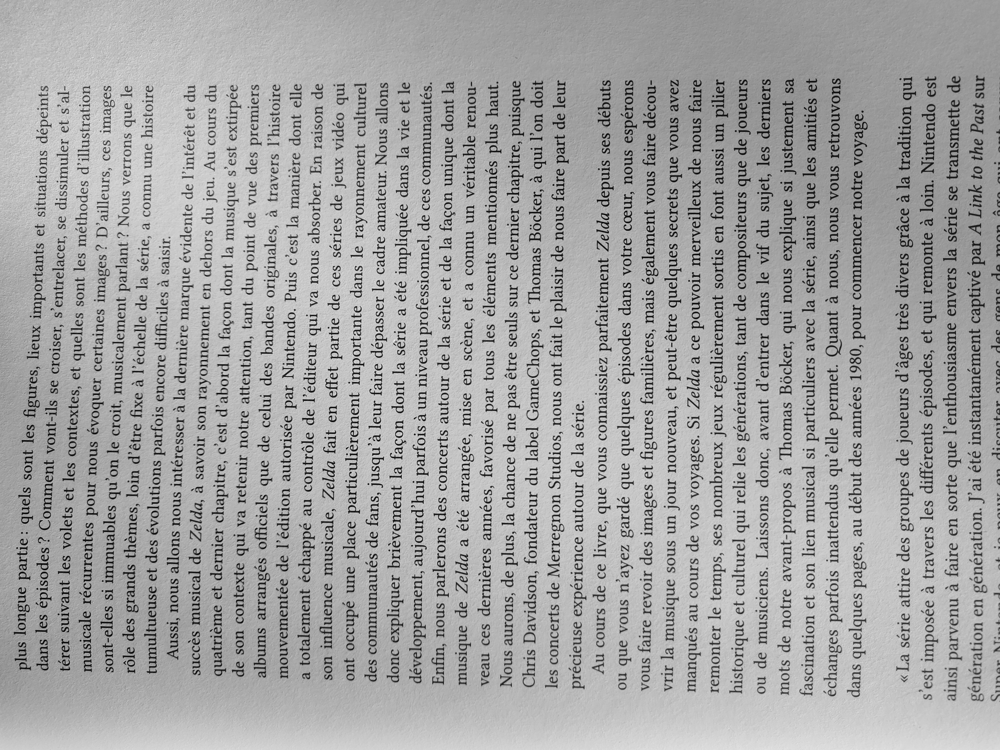

In [205]:
file_name = "./data/photos/img4.jpg"
full = utils.imread(file_name)
full

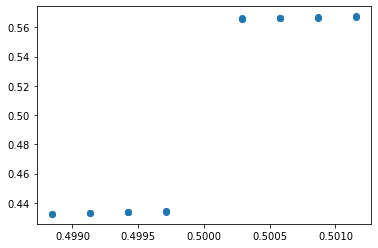

In [206]:
numpy_image = np.asarray(full)
TF = np.log(np.abs(np.fft.fftshift(np.fft.fft2(numpy_image))))
n, m = TF.shape
X, y = utils.find_brightest_pixels(TF * utils.middle_square(TF.shape, n//16, m//16), 20)
plt.scatter(X/M.shape[0], y/M.shape[1])

In [207]:
reg = LinearRegression().fit(X.reshape(-1, 1)/M.shape[0], y/M.shape[1])

alpha = np.arctan(reg.coef_)
alpha

array([1.5585351])

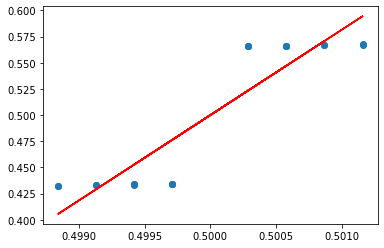

In [208]:
plt.scatter(X/M.shape[0], y/M.shape[1])
plt.plot(X/M.shape[0], reg.predict(X.reshape(-1, 1)/M.shape[0]), 'r')

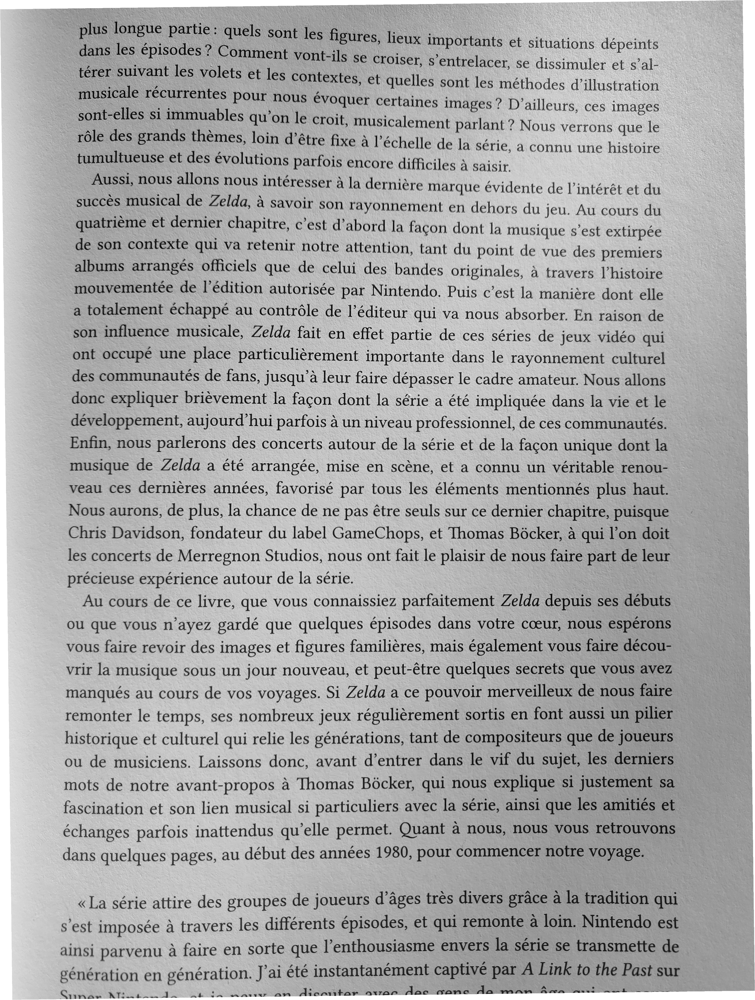

In [209]:
full = turn.rotation_PIL(full, -alpha)
full

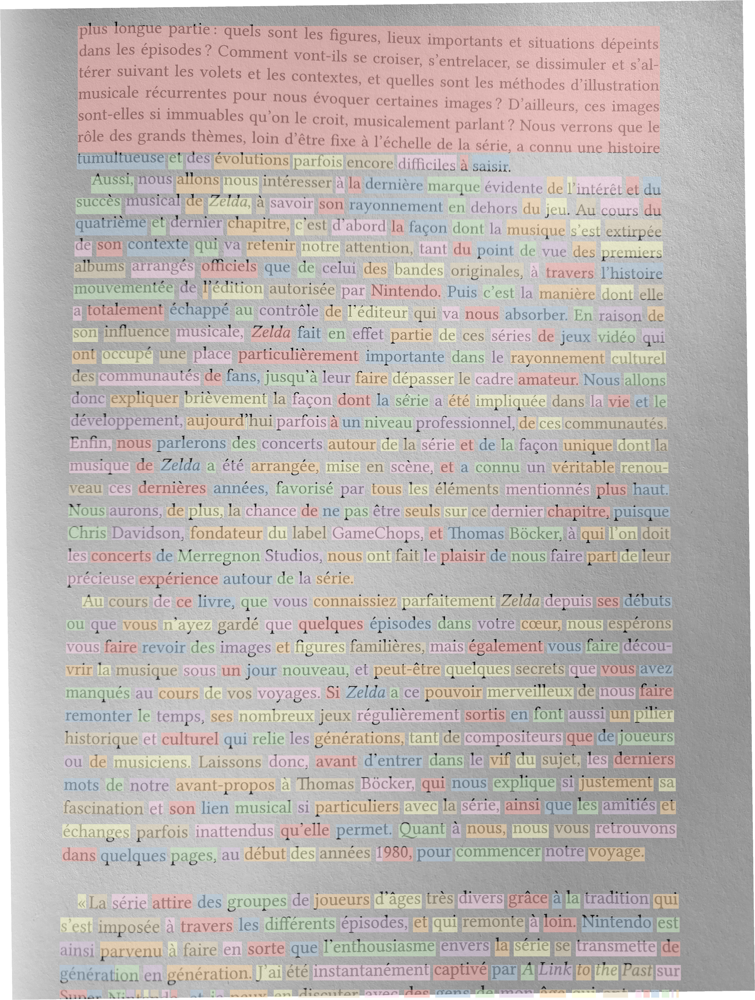

In [211]:
utils.segmentation(full, r=4)

In [165]:
import time

1.7208023071289062


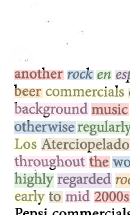

In [202]:
n, m = full.size
t0 = time.time()
test = utils.segmentation(full.crop((0, 0, n//4+0, m//4)), r=0.5)
print((time.time()-t0)*32)
test